# Self-Driving Car Engineer Nanodegree
## Project: Advanced Finding Lane Lines on the Road
----------------------
This project is an extension to the previous find lane line project. The previous approach assumes straight lane line markers that are clearly distinguishable from the ground. Therefore it fails on clearly curved roads, or/and when there is a shadow or extreme sunshine. This project aims to use more advanced algorithms to solve those problems.

### Import packages

In [1]:
#importing some useful packages
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import cv2
%matplotlib inline

### Calibrate the camera
Get the camera matrix `mtx` and distortion coefficients `dst` for image undistortion.

Processing ./camera_cal/calibration1.jpg
Processing ./camera_cal/calibration2.jpg
calibration2


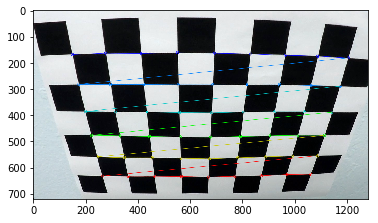

Processing ./camera_cal/calibration3.jpg
calibration3


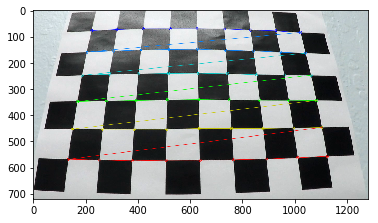

Processing ./camera_cal/calibration4.jpg
Processing ./camera_cal/calibration5.jpg
Processing ./camera_cal/calibration6.jpg
calibration6


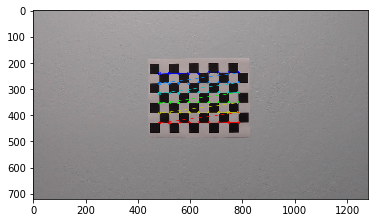

Processing ./camera_cal/calibration7.jpg
calibration7


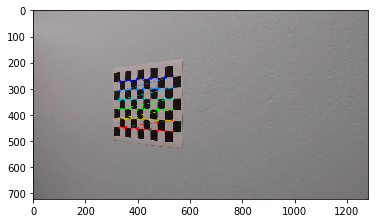

Processing ./camera_cal/calibration8.jpg
calibration8


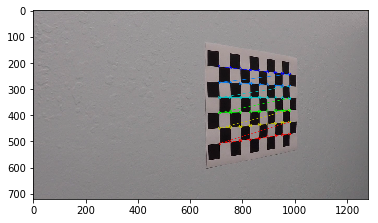

Processing ./camera_cal/calibration9.jpg
calibration9


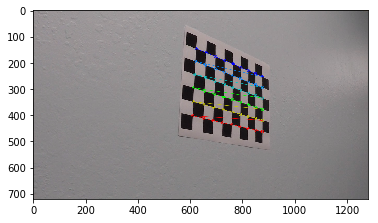

Processing ./camera_cal/calibration10.jpg
calibration10


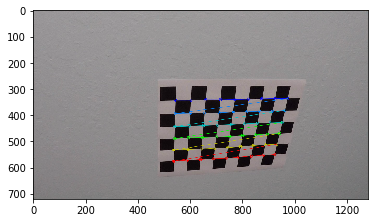

Processing ./camera_cal/calibration11.jpg
calibration11


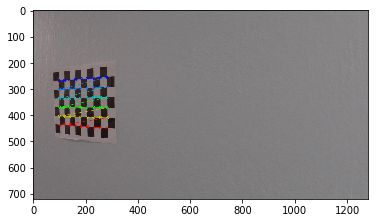

Processing ./camera_cal/calibration12.jpg
calibration12


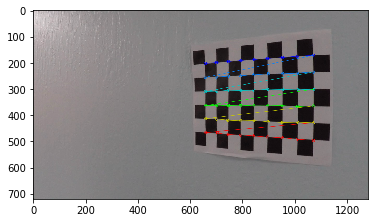

Processing ./camera_cal/calibration13.jpg
calibration13


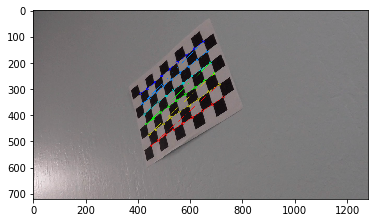

Processing ./camera_cal/calibration14.jpg
calibration14


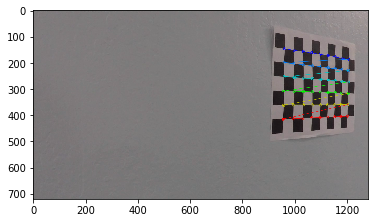

Processing ./camera_cal/calibration15.jpg
calibration15


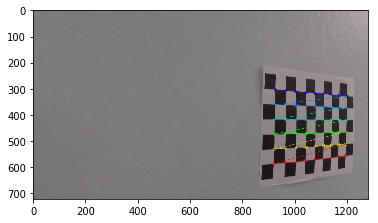

Processing ./camera_cal/calibration16.jpg
calibration16


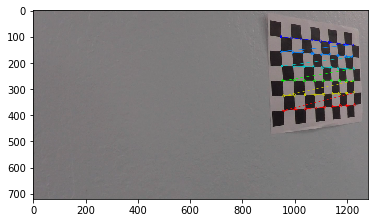

Processing ./camera_cal/calibration17.jpg
calibration17


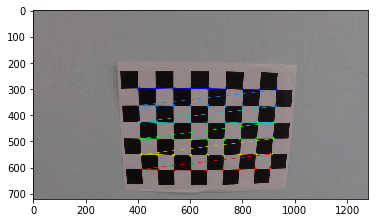

Processing ./camera_cal/calibration18.jpg
calibration18


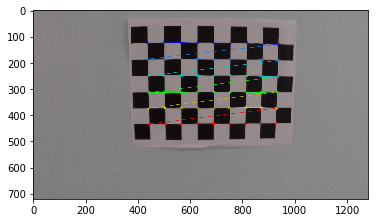

Processing ./camera_cal/calibration19.jpg
calibration19


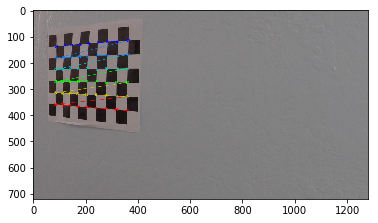

Processing ./camera_cal/calibration20.jpg
calibration20


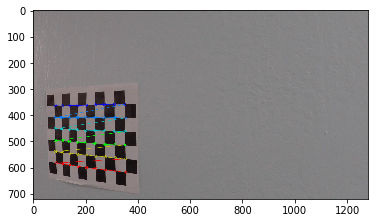

In [2]:
# number of corner points
nx = 9
ny = 6

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(8,5,0)
objp = np.zeros((nx * ny, 3), np.float32)
objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
for i in range(1,21):
    fname = './camera_cal/calibration' + str(i) + '.jpg'
    print('Processing', fname)
    img = cv2.imread(fname)
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    # Find the chessboard corners
    corner_size = (nx, ny)
    ret, corners = cv2.findChessboardCorners(gray, corner_size, None,
                                             cv2.CALIB_CB_ADAPTIVE_THRESH + cv2.CALIB_CB_NORMALIZE_IMAGE)
        
    # If found, draw corners
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)
        
        # Draw and display the corners
        cv2.drawChessboardCorners(img, corner_size, corners, ret)
        print('calibration' + str(i))
        plt.imshow(img)
        plt.show()

Processing ./camera_cal/calibration1.jpg


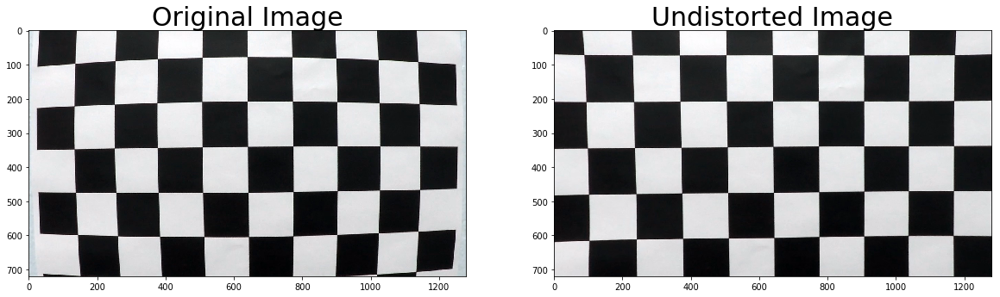

Processing ./camera_cal/calibration2.jpg


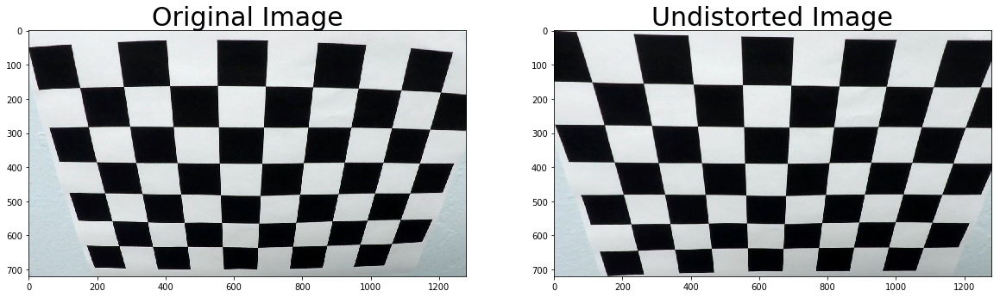

Processing ./camera_cal/calibration3.jpg


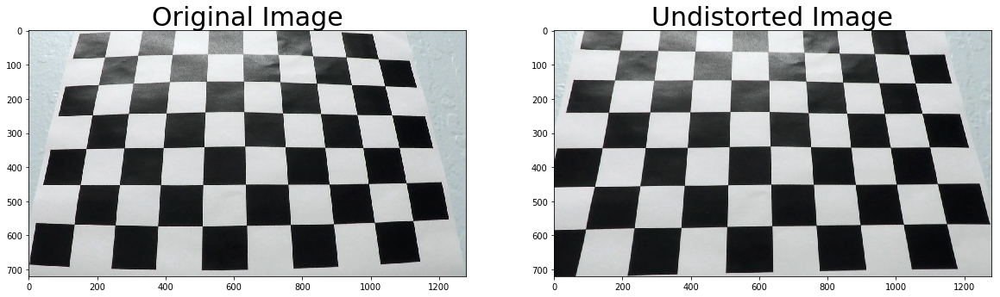

Processing ./camera_cal/calibration4.jpg


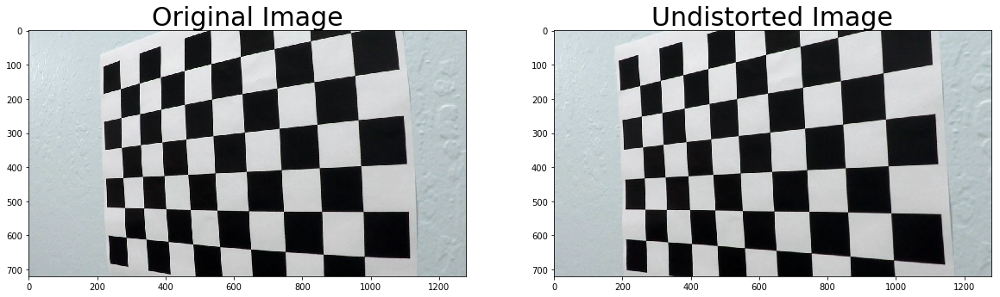

Processing ./camera_cal/calibration5.jpg


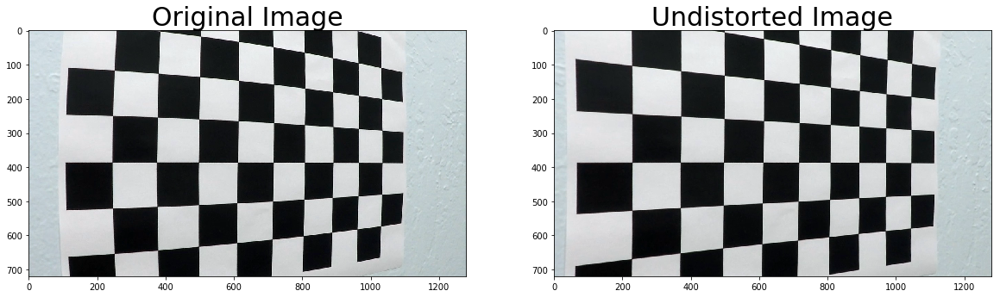

Processing ./camera_cal/calibration6.jpg


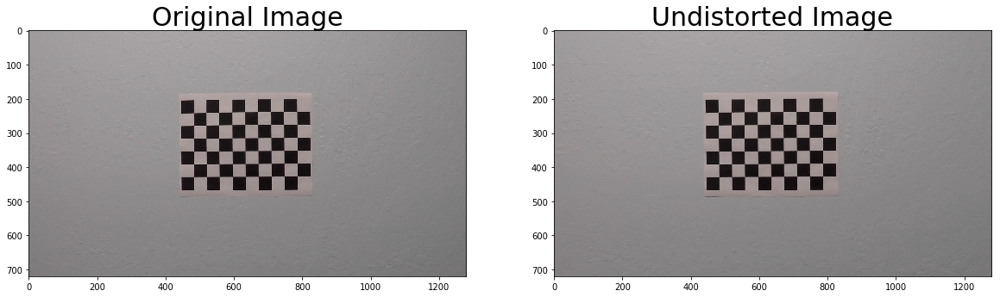

Processing ./camera_cal/calibration7.jpg


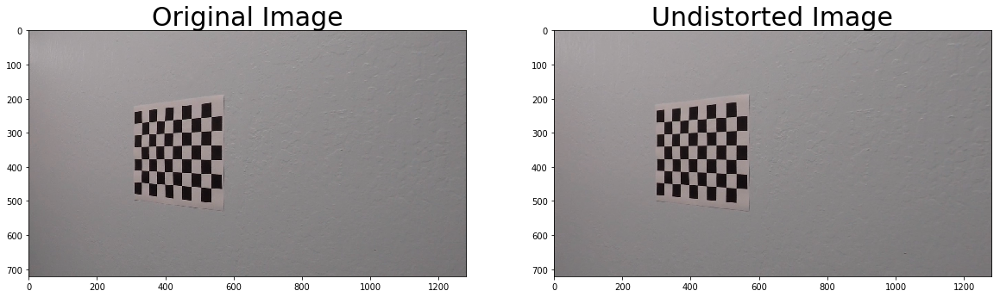

Processing ./camera_cal/calibration8.jpg


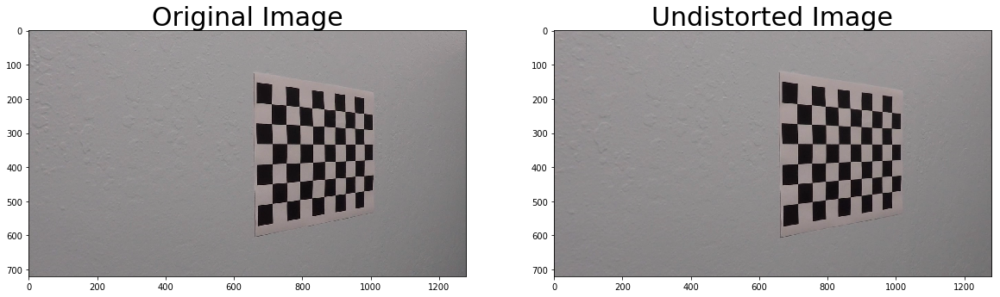

Processing ./camera_cal/calibration9.jpg


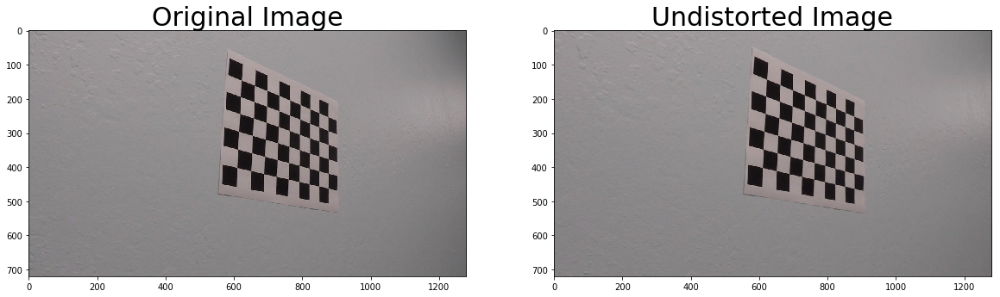

Processing ./camera_cal/calibration10.jpg


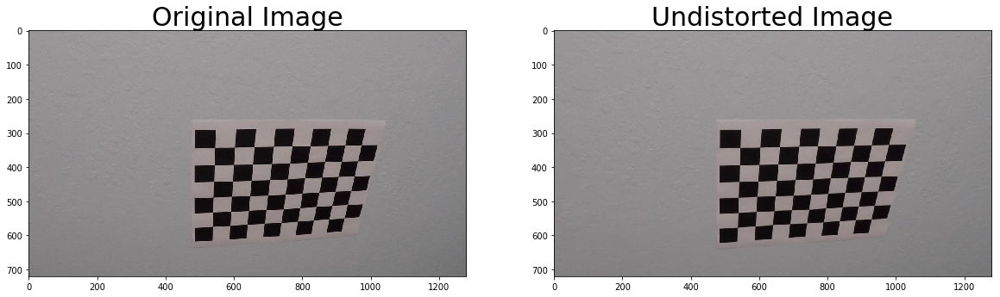

Processing ./camera_cal/calibration11.jpg


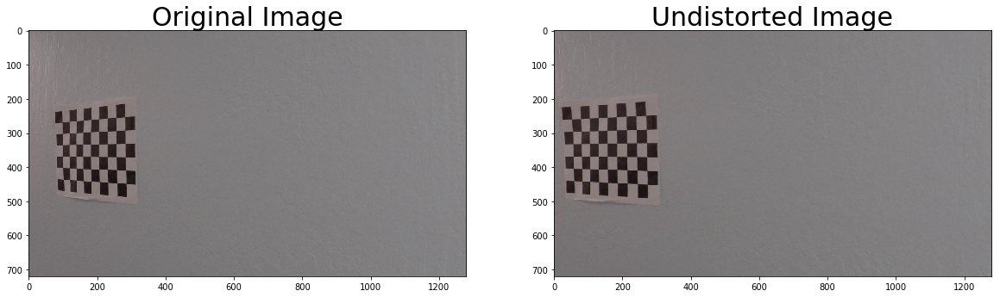

Processing ./camera_cal/calibration12.jpg


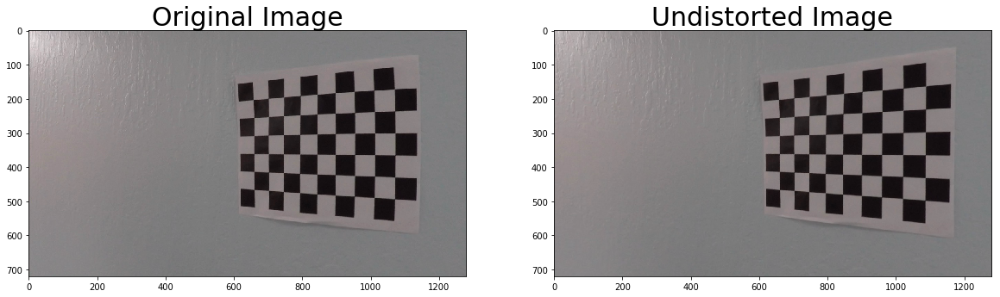

Processing ./camera_cal/calibration13.jpg


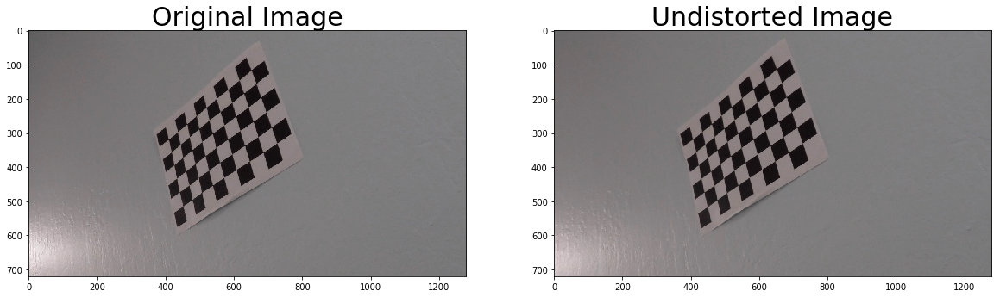

Processing ./camera_cal/calibration14.jpg


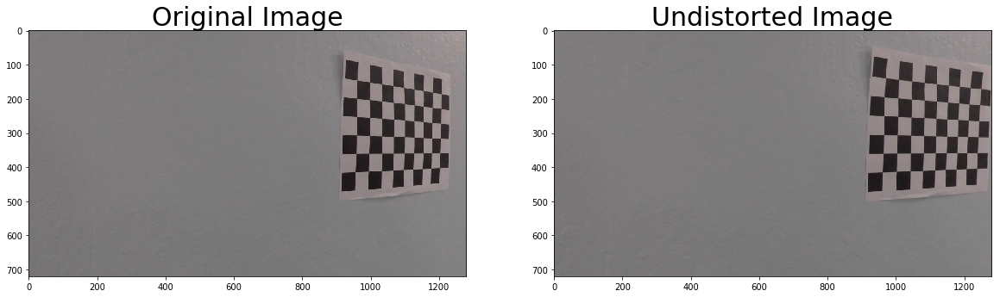

Processing ./camera_cal/calibration15.jpg


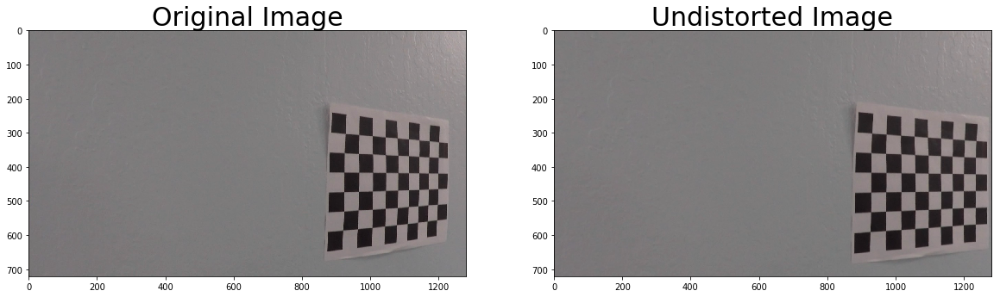

Processing ./camera_cal/calibration16.jpg


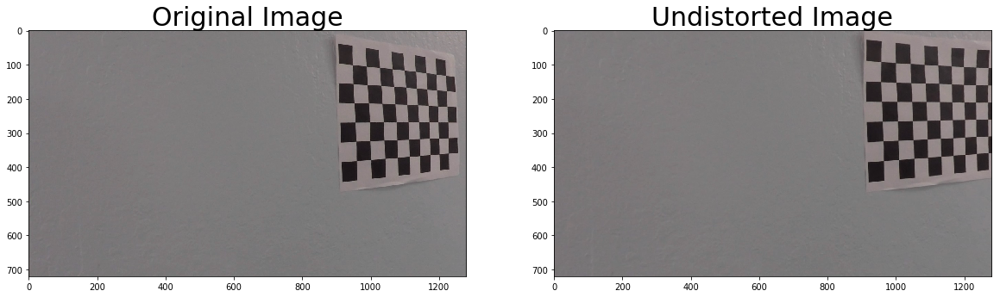

Processing ./camera_cal/calibration17.jpg


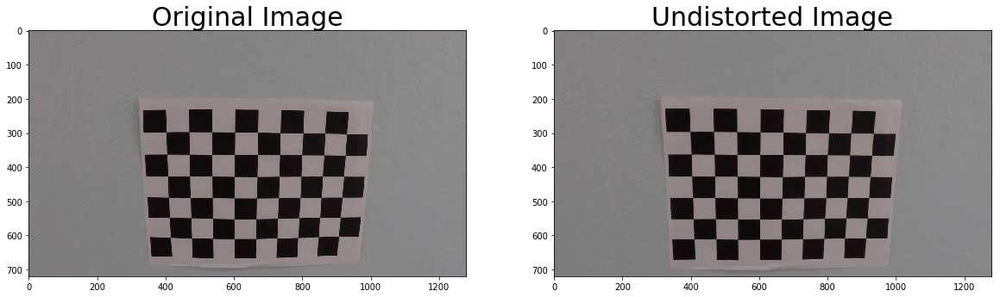

Processing ./camera_cal/calibration18.jpg


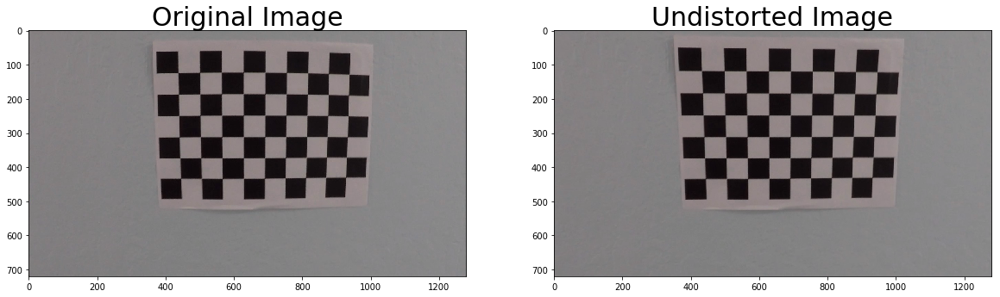

Processing ./camera_cal/calibration19.jpg


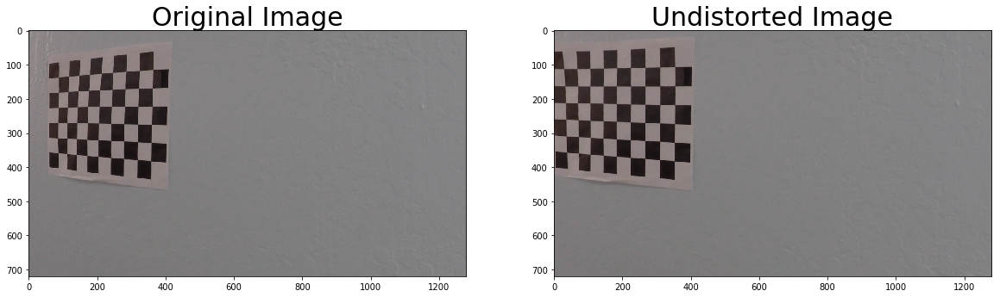

Processing ./camera_cal/calibration20.jpg


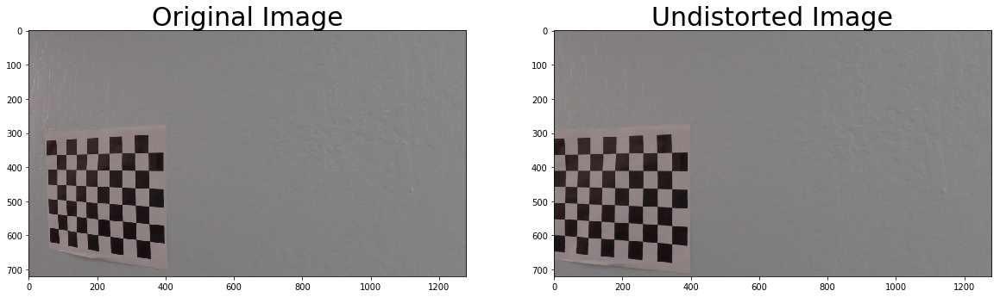

In [3]:
# test calibration of chessboard images
img = cv2.imread('./camera_cal/calibration1.jpg')
img_size = (img.shape[1], img.shape[0])
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)

for i in range(1,21):
    fname = './camera_cal/calibration' + str(i) + '.jpg'
    print('Processing', fname)
    img = cv2.imread(fname)
    #img_size = (img.shape[1], img.shape[0])
    #ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)
    undst = cv2.undistort(img, mtx, dist, None, mtx)
    cv2.imwrite('./camera_cal/calibrated/calibrated' + str(i) + '.jpg', undst)
    
    # Visualize undistortion
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(undst)
    ax2.set_title('Undistorted Image', fontsize=30)
    plt.show()

Processing ./test_images\straight_lines1.jpg


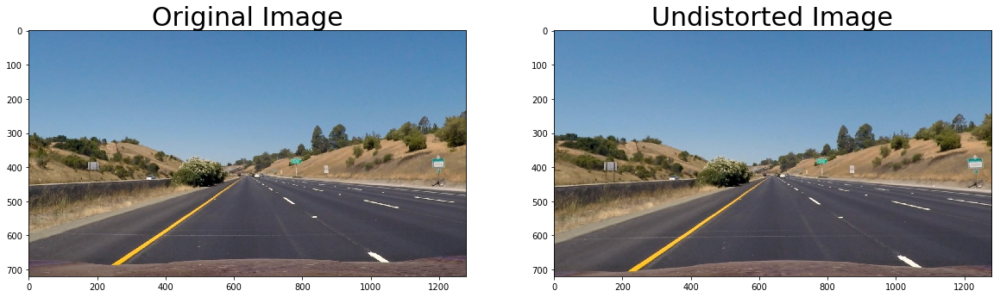

Processing ./test_images\straight_lines2.jpg


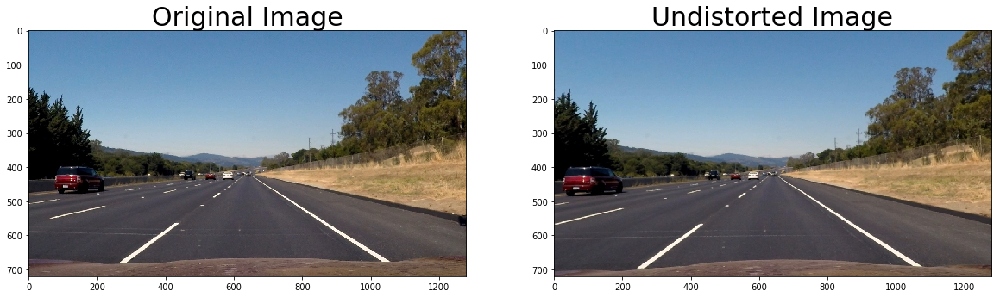

Processing ./test_images\test1.jpg


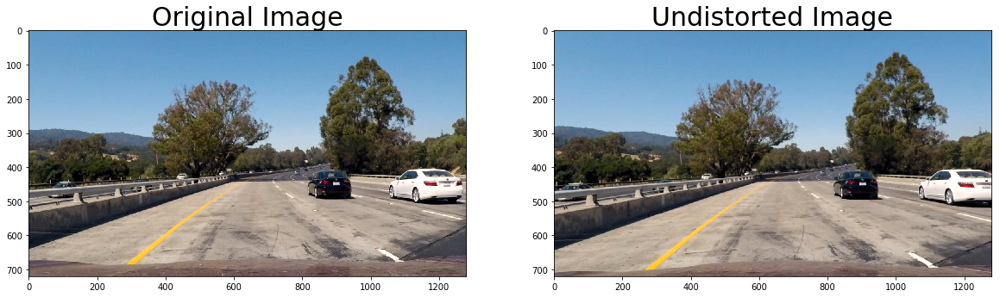

Processing ./test_images\test2.jpg


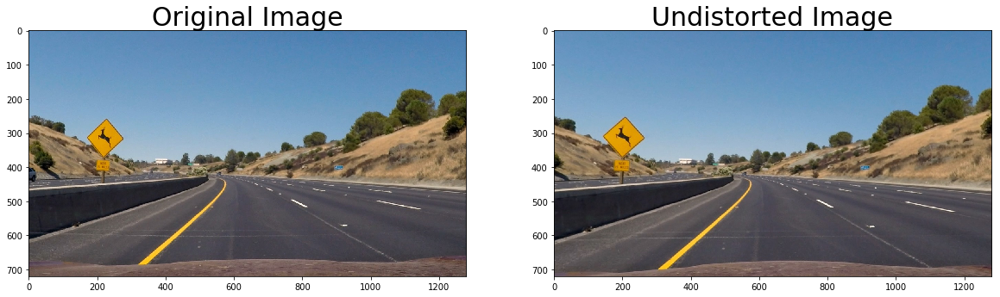

Processing ./test_images\test3.jpg


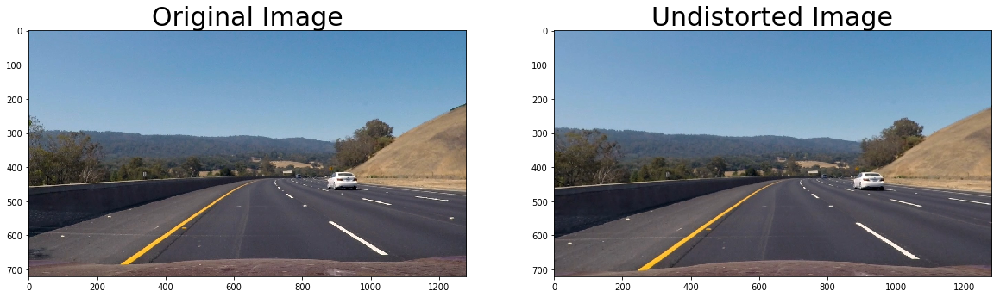

Processing ./test_images\test4.jpg


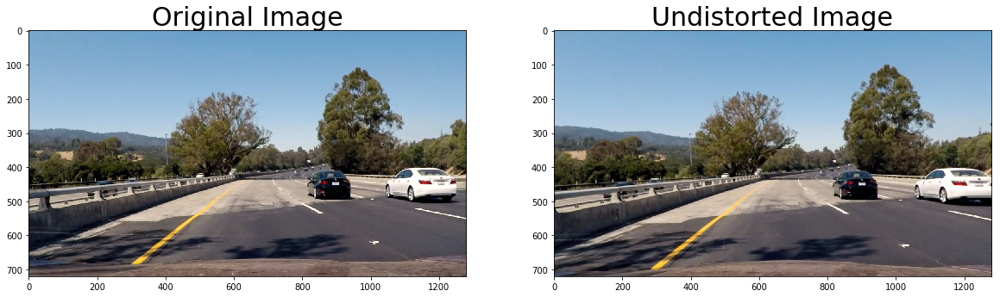

Processing ./test_images\test5.jpg


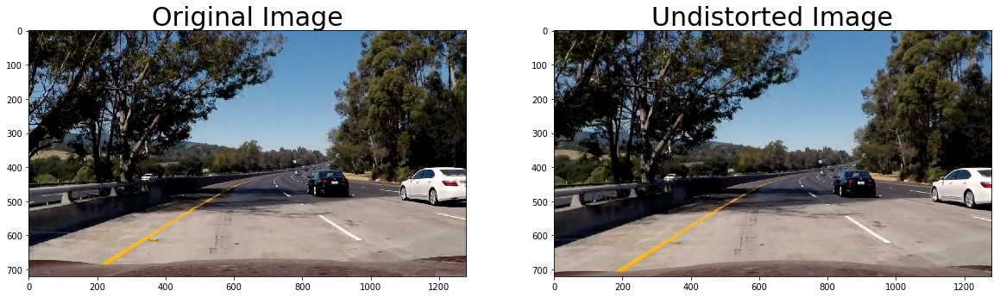

Processing ./test_images\test6.jpg


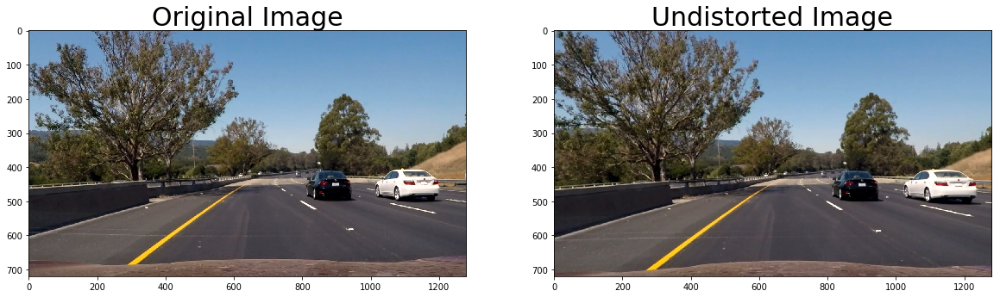

In [4]:
# undistort all test images
import glob

test_images = glob.glob('./test_images/*.jpg')
for fname in test_images:
    print('Processing', fname)
    img = cv2.imread(fname)
    undst = cv2.undistort(img, mtx, dist, None, mtx)
    cv2.imwrite('./test_images/undistorted/undst_' + fname.split('/')[-1], undst)
    
    # Visualize undistortion
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(cv2.cvtColor(undst, cv2.COLOR_BGR2RGB))
    ax2.set_title('Undistorted Image', fontsize=30)
    plt.show()

### Perspective Transform
Transform the viewing perspective from car view to top-down view. The transform matrix `M` is identified from the images with straight lane lines that will appear as straight and parallel lines.

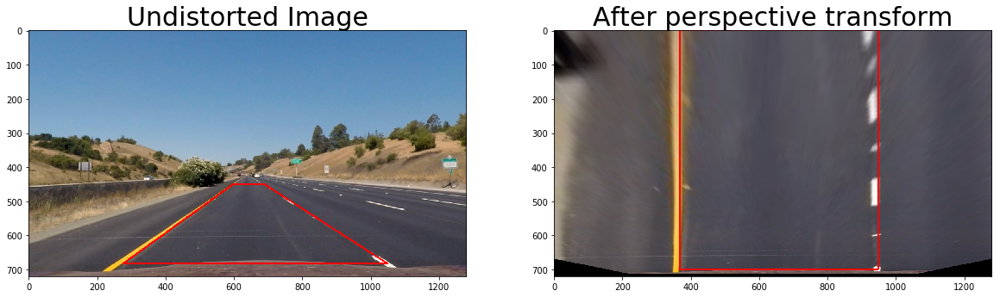

In [25]:
# use the second straight line image as the standard
img = cv2.imread('./test_images/undistorted/undst_straight_lines1.jpg')
#img = cv2.imread('./test_images/undistorted/undst_test6.jpg')

#src = np.float32([[593,453], [688, 453], [1053,687], [255, 687]])  # from straight_lines1
src = np.float32([[596,451], [690, 451], [1048,682], [276, 682]])  # from straight_lines2
dst = np.float32([[367, 0], [946, 0], [946, 700], [367, 700]])

M = cv2.getPerspectiveTransform(src, dst)
M_inv = cv2.getPerspectiveTransform(dst, src)
warped = cv2.warpPerspective(img, M, img_size)
cv2.imwrite('transformed_standard.jpg', warped) # save to measure conversion between pixel and length

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
cv2.polylines(img, [np.array(src, np.int32)], True, (0,0,255), 3)
ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
ax1.set_title('Undistorted Image', fontsize=30)
cv2.polylines(warped, [np.array(dst, np.int32)], True, (0,0,255), 3)
ax2.imshow(cv2.cvtColor(warped, cv2.COLOR_BGR2RGB))
ax2.set_title('After perspective transform', fontsize=30)
plt.show()

### Build binary masks to seperate lane line markers
Use a combination of gradient magnitude, gradient direction, HLS color, and etc. as the criterion for the threshold mask.

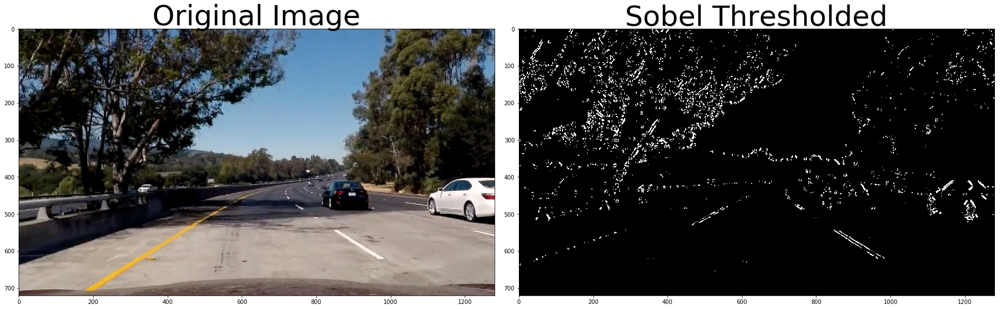

In [6]:
# sobel filters
# magnitude and direction are combined because both are calculated based on sobelx and sobely

def sobel_threshold(img, sobel_kernel=3, mag_th = (0, 255), dir_th=(0, np.pi/2)):
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # 2a) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, None, sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, None, sobel_kernel)
    # 2b) Take the absolute value of the x and y gradients
    abs_sobelx = np.absolute(sobelx)
    abs_sobely = np.absolute(sobely)
    
    ### magnitude mask ###
    # 1) Calculate the magnitude 
    mag = np.sqrt(np.square(sobelx) + np.square(sobely))
    mag = np.uint8(255 * mag / np.max(mag))
    # 2) Create a binary mask where magnitude thresholds are met
    mag_mask = np.zeros(mag.shape)
    mag_mask[(mag > mag_th[0]) & (mag <= mag_th[1])] = 1
    
    ### direction mask ###
    # 1) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
    direction = np.arctan2(abs_sobely, abs_sobelx)
    # 2) Create a binary mask where direction thresholds are met
    dir_mask = np.zeros_like(direction)
    dir_mask[(direction > dir_th[0]) & (direction < dir_th[1])] = 1
    
    # Return the combined mask
    binary_output = np.zeros_like(dir_mask)
    binary_output[(mag_mask == 1) & (dir_mask == 1)] = 1
    return binary_output

img = cv2.imread('./test_images/undistorted/undst_test5.jpg')
sobel_binary = sobel_threshold(img, sobel_kernel = 9, mag_th = (50, 255), dir_th = (0.3, 1.15))
# plot the results
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(sobel_binary, cmap='gray')
ax2.set_title('Sobel Thresholded', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

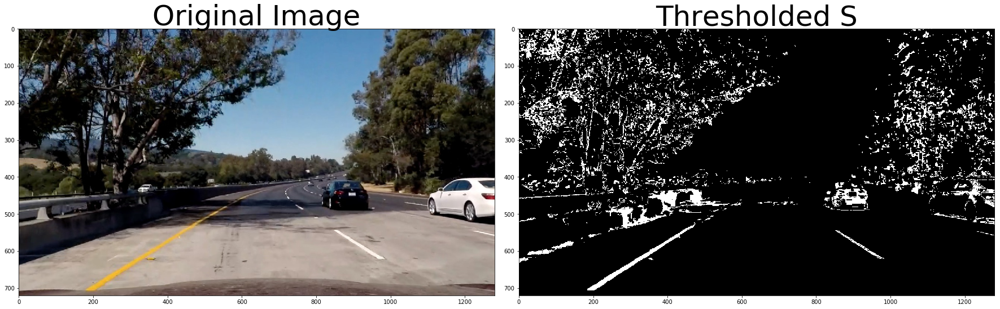

In [7]:
# HLS filter, convert to HLS to correct for sunshine/shadow related effects
def hls_threshold(img, thresh=(0, 255)):
    # 1) Convert to HLS color space
    hls = cv2.cvtColor(img, cv2.COLOR_BGR2HLS)
    s_ch = hls[:, :, 2]
    # 2) Apply a threshold to the S channel
    mask = np.zeros_like(s_ch)
    mask[(s_ch > thresh[0]) & (s_ch <= thresh[1])] = 1
    # 3) Return a binary image of threshold result
    return mask

img = cv2.imread('./test_images/undistorted/undst_test5.jpg')
hls_binary = hls_threshold(img, thresh=(150, 255))

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(hls_binary, cmap='gray')
ax2.set_title('Thresholded S', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

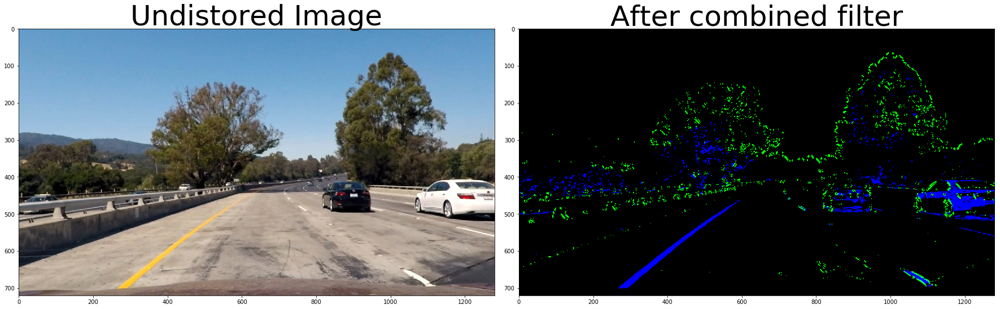

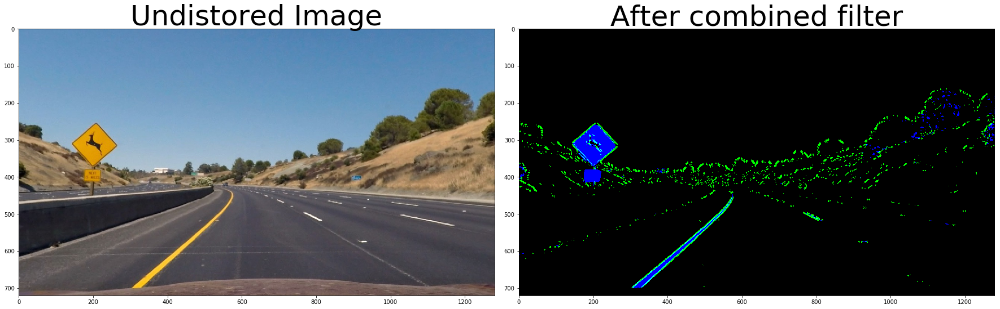

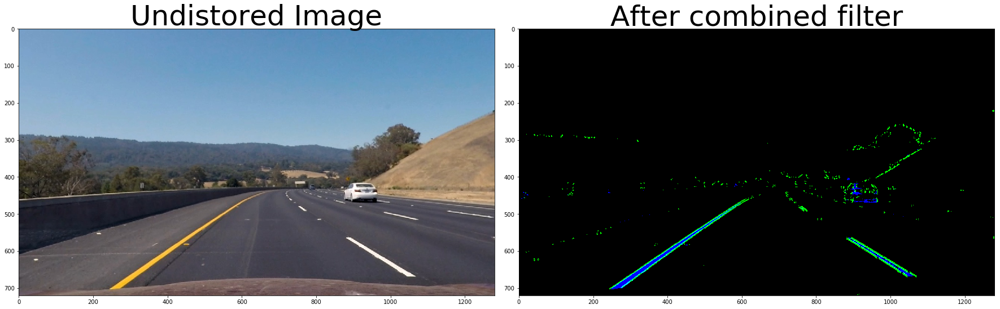

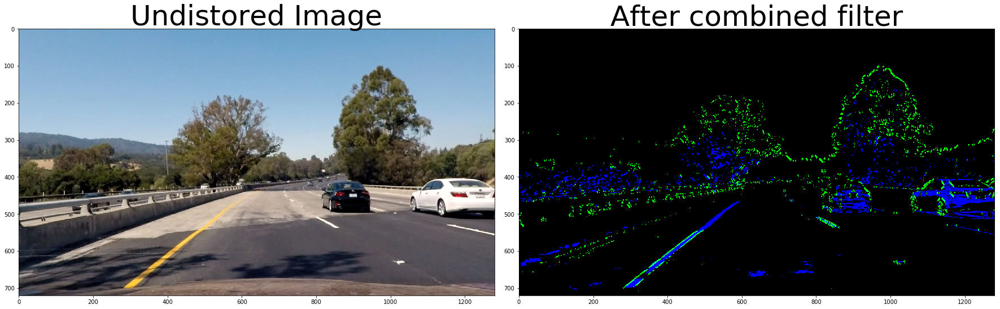

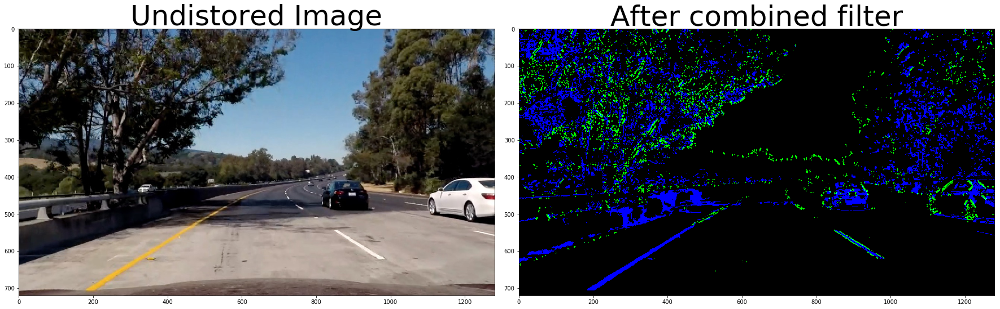

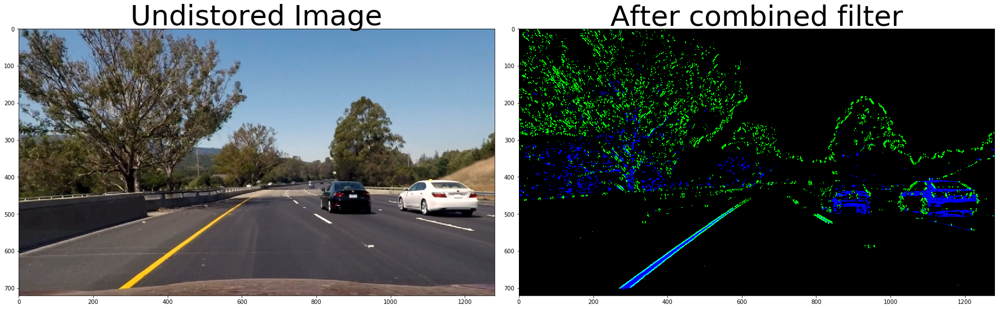

In [26]:
# combined filter
def combined_filter(img, sobel_kernel = 3, mag_th = (0, 255), dir_th=(0, np.pi/2), s_th=(0, 255)):
    sobel_binary = sobel_threshold(img, sobel_kernel=sobel_kernel, mag_th=mag_th, dir_th=dir_th)
    hls_binary = hls_threshold(img, thresh=s_th)
    color_binary = np.dstack(( np.zeros_like(sobel_binary), sobel_binary, hls_binary))
    return color_binary

for i in range(1, 7):
    img = cv2.imread('./test_images/undistorted/undst_test' + str(i) + '.jpg')
    color_binary = combined_filter(img, sobel_kernel=9, mag_th=(50, 255), dir_th=(0.3, 1.15), s_th=(150, 255))

    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax1.set_title('Undistored Image', fontsize=50)
    ax2.imshow(color_binary)
    ax2.set_title('After combined filter', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()

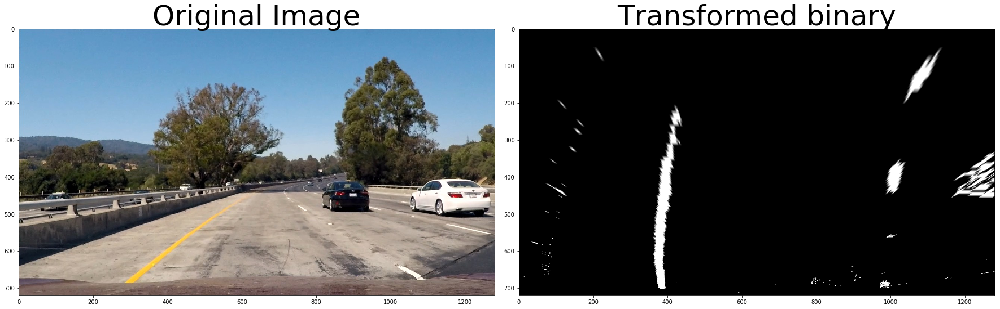

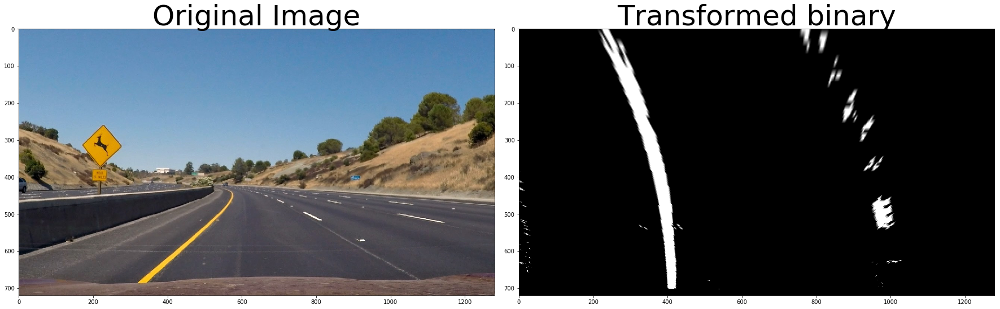

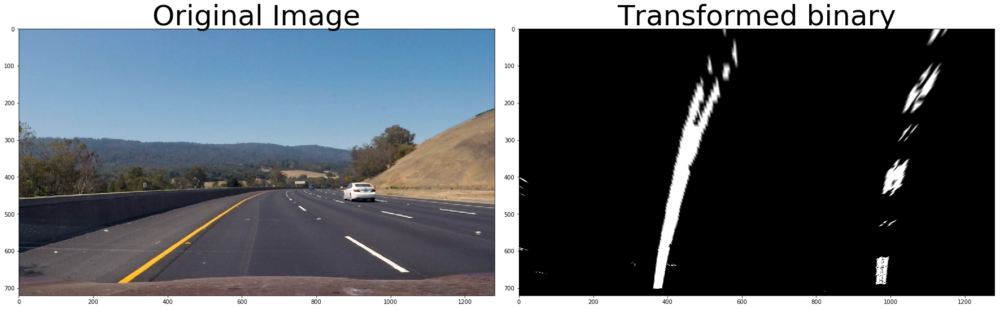

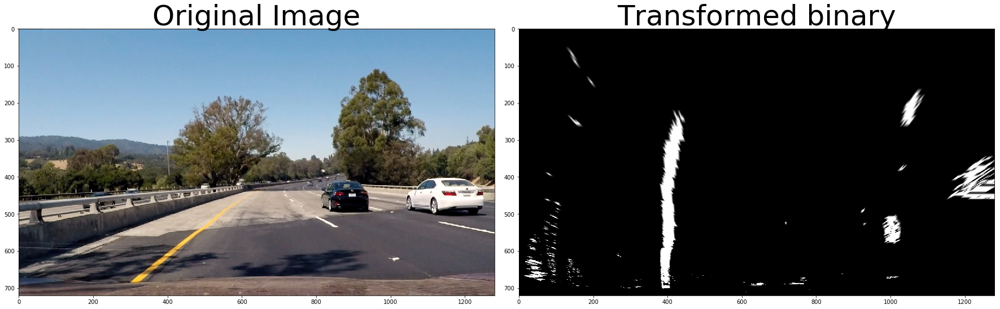

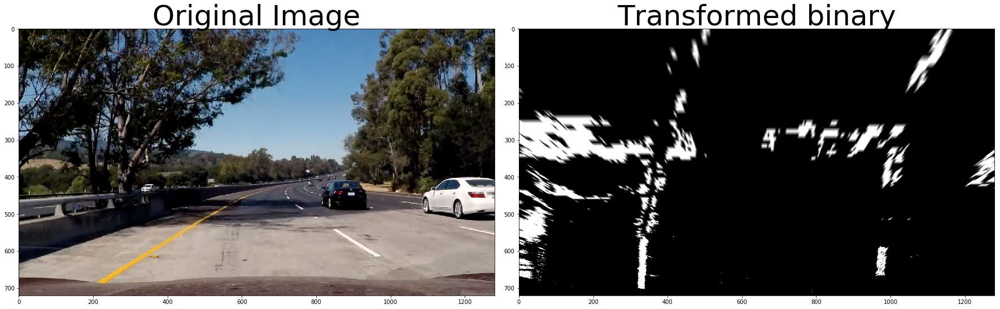

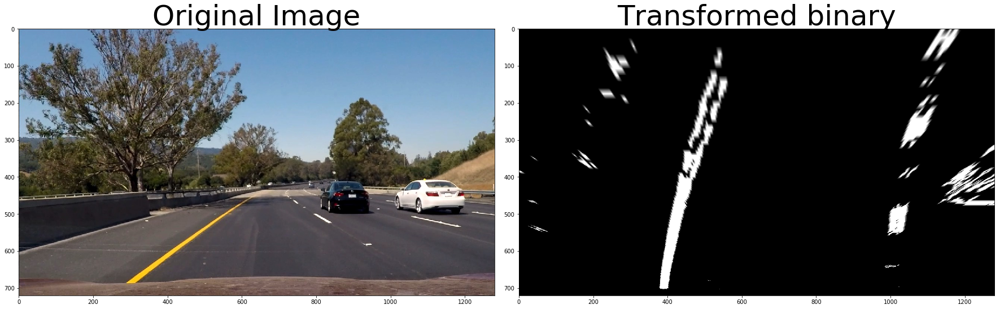

In [9]:
# test the pipeline that do:
# 1. undistort
# 2. combined filter
# 3. perspective tranform
# 4. return transformed binary map
def image_to_binary(img, mtx, dist, M,
                   sobel_kernel=9, mag_th=(50, 255), dir_th=(0.3, 1.15), s_th=(150, 255)):
    undistorted = cv2.undistort(img, mtx, dist, None, mtx)
    filtered = combined_filter(img, sobel_kernel, mag_th, dir_th, s_th)
    filtered_binary = np.zeros(filtered.shape[:2])
    filtered_binary[(filtered[:,:,1]==1) | (filtered[:,:,2]==1)] = 1
    warped = cv2.warpPerspective(filtered_binary, M, filtered_binary.shape[::-1])
    return warped

for i in range(1,7):
    img = cv2.imread('./test_images/test' + str(i) + '.jpg')
    warped = image_to_binary(img, mtx, dist, M)

    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(warped, cmap = 'gray')
    ax2.set_title('Transformed binary', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()

### Find lane line point
Now that potential lane line points are identified using sobel filter and HSL filter, a sliding window method will be applied to further identify the points in potential line regions.

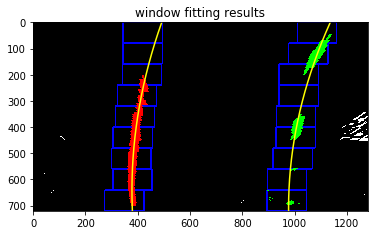

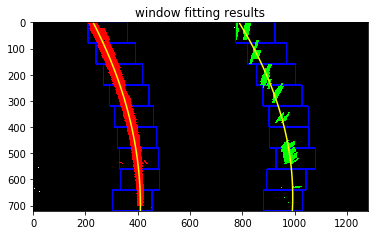

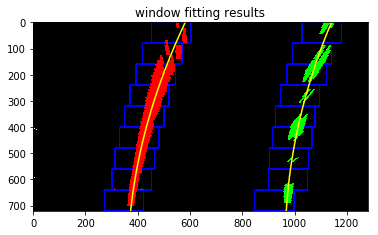

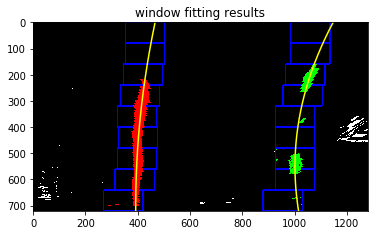

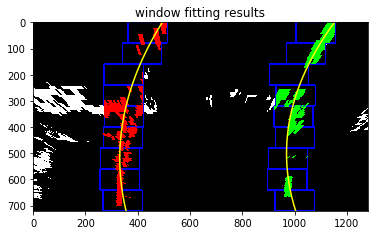

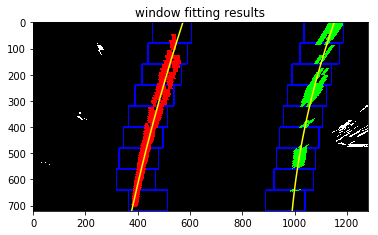

In [10]:
# find lane line points using the sliding window method
def find_line_pts_sliding_window(binary_img, window_width = 150, window_height = 80, minpix = 10):
    '''
    assuming input image is binary map
    output a colored image with lanes labeled, and all left points, all right points
    '''
    out_img = np.array(np.dstack((binary_img,binary_img,binary_img)),np.uint8) * 255
    window_centroids = [] # Store the (left,right) window centroid positions per level
    window = np.ones(window_width) # Create our window template that we will use for convolutions
    # Use window_width/2 as offset because convolution signal reference is at right side of window, not center of window
    offset = window_width//2
    margin = window_width//2
    
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    l_idx = []
    r_idx = []
    
    # find starting window positions using the bottom 1/4 of the image
    l_sum = np.sum(binary_img[3*binary_img.shape[0]//4:, 100:binary_img.shape[1]//2], axis=0)
    l_base = np.argmax(np.convolve(window,l_sum)) - offset + 100
    r_sum = np.sum(binary_img[3*binary_img.shape[0]//4:, binary_img.shape[1]//2:-100], axis=0)
    r_base = np.argmax(np.convolve(window,r_sum)) - offset + binary_img.shape[1]//2
    # start from base
    l_cur = l_base
    r_cur = r_base
    
    # Go through other layers for max pixel locations
    for level in range(0,(int)(binary_img.shape[0]/window_height)):
        # add centroid position
        window_centroids.append((l_cur,r_cur))
        
        # Find window boundaries
        y_min = binary_img.shape[0] - (level+1)*window_height
        y_max = binary_img.shape[0] - (level)*window_height
        l_min = int(max(l_cur - margin,0))
        l_max = int(min(l_cur + margin, binary_img.shape[1]))
        r_min = int(max(r_cur - margin,0))
        r_max = int(min(r_cur + margin, binary_img.shape[1]))
        
        # draw window bonds
        cv2.rectangle(out_img,(l_min,y_min),(l_max,y_max),(0,0,255), 3) 
        cv2.rectangle(out_img,(r_min,y_min),(r_max,y_max),(0,0,255), 3) 
        
        # find valid points in window
        valid_left_idx = ((nonzeroy >= y_min) & (nonzeroy < y_max) & (nonzerox >= l_min) & (nonzerox < l_max)).nonzero()[0]
        valid_right_idx = ((nonzeroy >= y_min) & (nonzeroy < y_max) & (nonzerox >= r_min) & (nonzerox < r_max)).nonzero()[0]

        l_idx.append(valid_left_idx)
        r_idx.append(valid_right_idx)
        
        # If you found > minpix pixels, recenter next window on their mean position
        if len(valid_left_idx) > minpix:
            l_cur = np.int(np.mean(nonzerox[valid_left_idx]))
        if len(valid_right_idx) > minpix:        
            r_cur = np.int(np.mean(nonzerox[valid_right_idx]))
            
    # Concatenate the arrays of indices
    l_idx = np.concatenate(l_idx)
    r_idx = np.concatenate(r_idx)
    
    # mark selected lane points
    out_img[nonzeroy[l_idx], nonzerox[l_idx]] = [255, 0, 0]
    out_img[nonzeroy[r_idx], nonzerox[r_idx]] = [0, 255, 0]

    # Extract left and right line pixel positions
    leftx = nonzerox[l_idx]
    lefty = nonzeroy[l_idx] 
    rightx = nonzerox[r_idx]
    righty = nonzeroy[r_idx] 
    
    return out_img, leftx, lefty, rightx, righty

for i in range(1,7):
    img = cv2.imread('./test_images/test' + str(i) + '.jpg')
    warped_binary = image_to_binary(img, mtx, dist, M)
    output, leftx, lefty, rightx, righty = find_line_pts_sliding_window(warped_binary)
    plt.imshow(output)
    plt.title('window fitting results')
    
    # get poly fit of lane points
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, warped_binary.shape[0]-1, warped_binary.shape[0] )
    left_fitx = np.polyval(left_fit, ploty)
    right_fitx = np.polyval(right_fit, ploty)
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)
    plt.show()

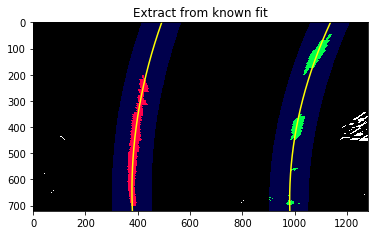

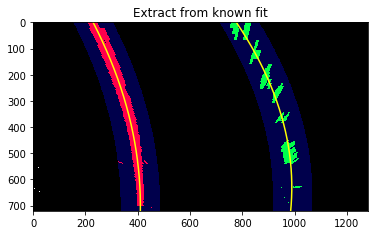

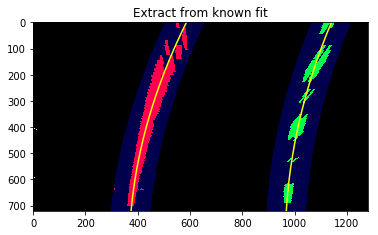

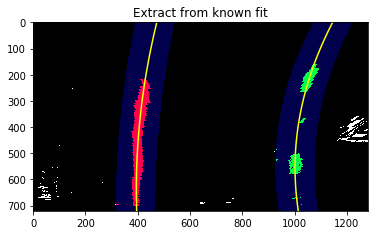

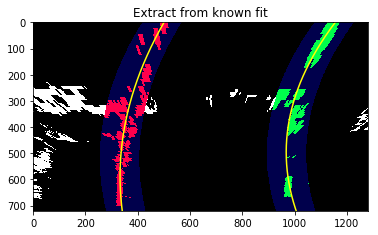

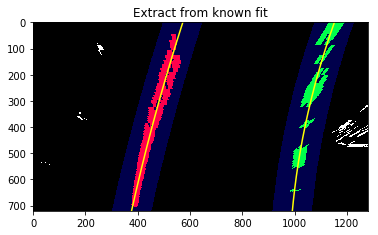

In [27]:
# find lane lines from a previously given lane fit
def find_line_pts_from_fit(binary_img, left_fit, right_fit, window_width = 150):
    out_img = np.array(np.dstack((binary_img,binary_img,binary_img)),np.uint8) * 255
    window_img = np.zeros_like(out_img)
    margin = window_width//2
    
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    # index of points in window
    left_fit_nzx = np.polyval(left_fit, nonzeroy)
    right_fit_nzx = np.polyval(right_fit, nonzeroy)
    l_idx = ((nonzerox > (left_fit_nzx - margin)) & (nonzerox < (left_fit_nzx + margin))) 
    r_idx = ((nonzerox > (right_fit_nzx - margin)) & (nonzerox < (right_fit_nzx + margin)))
    
    # mark selected lane points
    out_img[nonzeroy[l_idx], nonzerox[l_idx]] = [255, 0, 0]
    out_img[nonzeroy[r_idx], nonzerox[r_idx]] = [0, 255, 0]
    
    # Extract left and right line pixel positions
    leftx = nonzerox[l_idx]
    lefty = nonzeroy[l_idx] 
    rightx = nonzerox[r_idx]
    righty = nonzeroy[r_idx] 
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_img.shape[0]-1, binary_img.shape[0] )
    left_plotx = np.polyval(left_fit, ploty)
    right_plotx = np.polyval(right_fit, ploty)
    
    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_plotx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_plotx+margin, ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_plotx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_plotx+margin, ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,0,255))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,0,255))
    out_img = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    return out_img, leftx, lefty, rightx, righty

for i in range(1,7):
    img = cv2.imread('./test_images/test' + str(i) + '.jpg')
    warped_binary = image_to_binary(img, mtx, dist, M)
    _, leftx, lefty, rightx, righty = find_line_pts_sliding_window(warped_binary)
    
    # get poly fit of lane points
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # find pts using the fit
    output, leftx, lefty, rightx, righty = find_line_pts_from_fit(warped_binary, left_fit, right_fit)
    plt.imshow(output)
    plt.title('Extract from known fit')
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, warped_binary.shape[0]-1, warped_binary.shape[0] )
    # get the new fit
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    left_fitx = np.polyval(left_fit, ploty)
    right_fitx = np.polyval(right_fit, ploty)
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)
    plt.show()

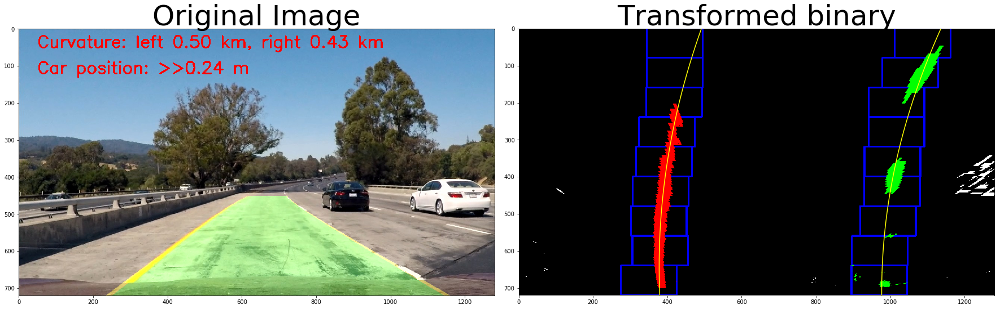

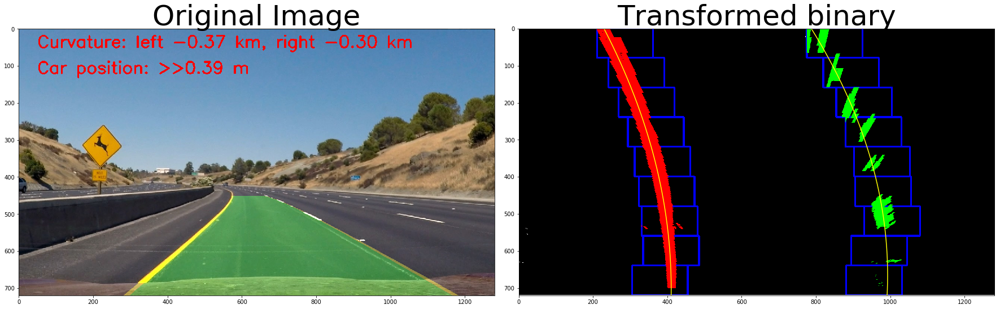

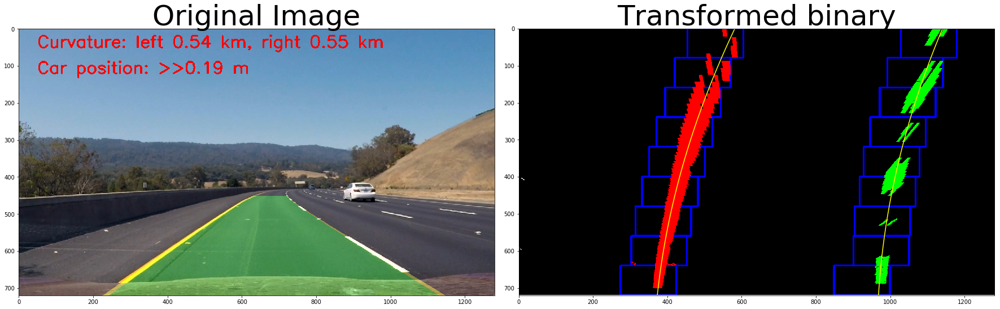

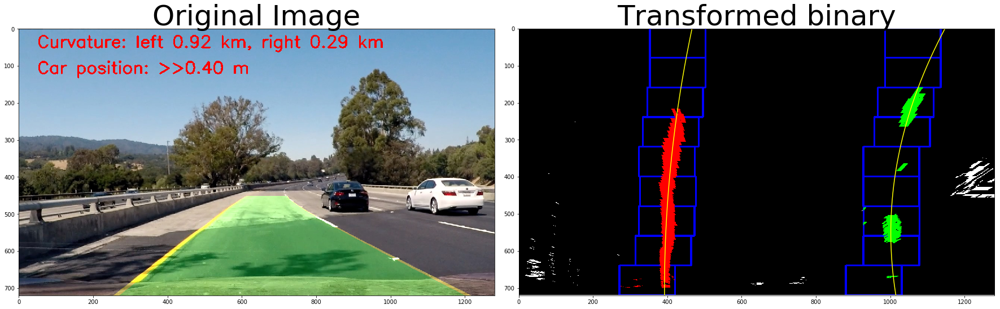

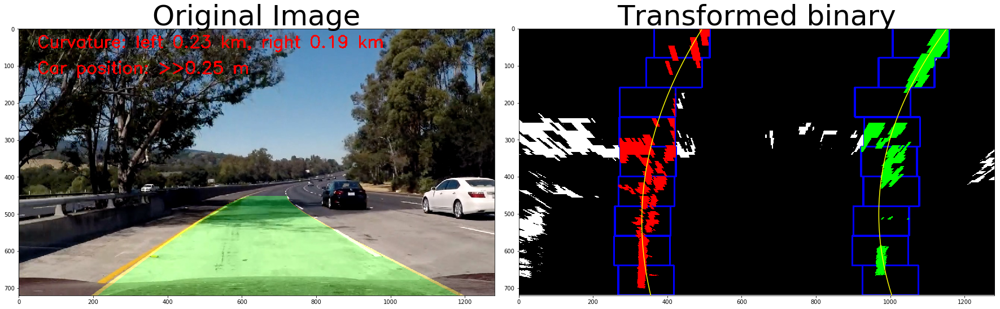

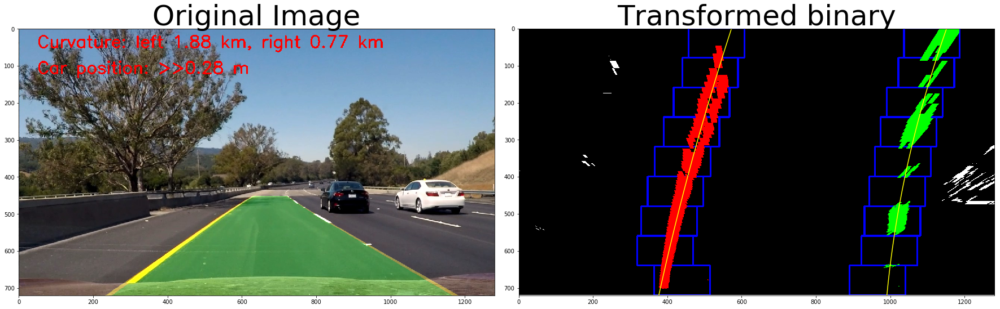

In [29]:
# calculate curvature and car position offset from left and right fits
def get_curvature_offset(left_fit, right_fit, y_eval):
    '''
    After perspective transform on the straight line images,
    lane width is ~583 pixels (3.7 m),
    and lane marker length is ~30.0 m (720 pixels).
    To convert poly fit to meter unit:
    x(y) = Ay^2 + By + C
    => xm(y) = xm_per_pix * (Ay^2 + By + C) 
             = xm_per_pix * (A*(ym/ym_per_pix)^2 + B*(ym/ym_per_pix) + C)
             = (xm_per_pix*A/ym_per_pix^2) * ym^2 + (xm_per_pix*B/ym_per_pix) * ym + (xm_per_pix*C)
             = Am * ym^2 + Bm * ym + Cm
    '''
    ym_per_pix = 30.0/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/583 # meters per pixel in x dimension
    
    ym_eval = y_eval * ym_per_pix
    left_Am = left_fit[0] * xm_per_pix / (ym_per_pix ** 2)
    left_Bm = left_fit[1] * xm_per_pix / ym_per_pix
    left_curverad = ((1 + (2*left_Am*ym_eval + left_Bm)**2)**1.5) / (2*left_Am)
    right_Am = right_fit[0] * xm_per_pix / (ym_per_pix ** 2)
    right_Bm = right_fit[1] * xm_per_pix / ym_per_pix
    right_curverad = ((1 + (2*right_Am*ym_eval + right_Bm)**2)**1.5) / (2*right_Am)
    
    # find car position
    left_lane_pos = np.polyval(left_fit, y_eval)
    right_lane_pos = np.polyval(right_fit, y_eval)
    mid_lane_pos = (left_lane_pos + right_lane_pos) / 2.0
    car_pos = (mid_lane_pos - (img.shape[1]/2)) * xm_per_pix
    
    return left_curverad, right_curverad, car_pos

def draw_road_info(img, left_curverad, right_curverad, car_pos):
    curv_txt = 'Curvature: left %.2f km, right %.2f km' % (left_curverad/1000.0, right_curverad/1000.0)
    cv2.putText(img, curv_txt, (50,50), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (0,0,255), 3)
    
    car_pos_str = ('>>%.2f m  ' % abs(car_pos)) if car_pos >= 0.0 else ('  %.2f m<<' % abs(car_pos))
    car_pos_txt = 'Car position: ' + car_pos_str
    cv2.putText(img, car_pos_txt, (50,120), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (0,0,255), 3)
    
    return img

# plot the lane back to the original image
def draw_lanes_on_image(img, left_fit, right_fit, M_inv):
    lane_warp = np.zeros_like(img).astype(np.uint8)

    # Recast the x and y points into usable format for cv2.fillPoly()
    ploty = np.linspace(0, img.shape[0]-1, img.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(lane_warp, np.int_([pts]), (0, 255, 0))
    cv2.polylines(lane_warp, np.int_([pts_left, pts_right]), False, (0, 255, 255), 10)

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(lane_warp, M_inv, (img.shape[1], img.shape[0])) 
    # Combine the result with the original image
    img = cv2.addWeighted(img, 1, newwarp, 0.3, 0)
    
    # add text about the curvature
    left_curverad, right_curverad, car_pos = get_curvature_offset(left_fit, right_fit, img.shape[0]-1)
    img = draw_road_info(img, left_curverad, right_curverad, car_pos)
    
    return img
    
for i in range(1,7):
    img = cv2.imread('./test_images/test' + str(i) + '.jpg')
    warped_binary = image_to_binary(img, mtx, dist, M)
    bird_view, leftx, lefty, rightx, righty = find_line_pts_sliding_window(warped_binary)
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    new_img = draw_lanes_on_image(img, left_fit, right_fit, M_inv)
    cv2.imwrite('./test_images/patched/patched_test' + str(i) + '.jpg', new_img)

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(cv2.cvtColor(new_img, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(bird_view, cmap = 'gray')
    ax2.set_title('Transformed binary', fontsize=50)
    ploty = np.linspace(0, warped_binary.shape[0]-1, warped_binary.shape[0] )
    left_fitx = np.polyval(left_fit, ploty)
    right_fitx = np.polyval(right_fit, ploty)
    ax2.plot(left_fitx, ploty, color='yellow')
    ax2.plot(right_fitx, ploty, color='yellow')
    ax2.set_xlim(0, 1280)
    ax2.set_ylim(720, 0)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()

### Test on video
Test the image processing pipeline on video (continuous sequence of images)!

In [13]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [14]:
class Line():
    def __init__(self):
        from collections import deque
        self.frame_window = 10
        self.detected = False
        self.recent_x = deque([], maxlen = self.frame_window)
        self.recent_y = deque([], maxlen = self.frame_window)
        self.min_hit_pts = 10000
        
    def get_proposed_fit(self):
        if len(self.recent_x) > 0:
            allx = np.hstack(self.recent_x)
            ally = np.hstack(self.recent_y)
            return np.polyfit(ally, allx, 2)
        else:
            return None, None
    
    def add_new_pts(self, new_x, new_y):
        if new_x is not None and new_y is not None and len(new_x) == len(new_y):
            self.recent_x.append(new_x)
            self.recent_y.append(new_y)
            if len(new_y) < self.min_hit_pts:
                self.detected = False
            else:
                self.detected = True

In [15]:
left_lane = Line()
right_lane = Line()
global_id = 0

def process_image(image, left_lane = left_lane, right_lane = right_lane):
    global global_id
    warped_binary = image_to_binary(image, mtx, dist, M)
    left_fit, right_fit = left_lane.get_proposed_fit(), right_lane.get_proposed_fit()
    if not left_lane.detected or not right_lane.detected:
        _, leftx, lefty, rightx, righty = find_line_pts_sliding_window(warped_binary)
    else:
        _, leftx, lefty, rightx, righty = find_line_pts_from_fit(warped_binary, left_fit, right_fit)
        
    left_lane.add_new_pts(leftx, lefty)
    right_lane.add_new_pts(rightx, righty)
    left_fit, right_fit = left_lane.get_proposed_fit(), right_lane.get_proposed_fit()
    new_img = draw_lanes_on_image(image, left_fit, right_fit, M_inv)
    #cv2.putText(new_img, str(global_id), (50,180), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (0,0,255), 3)
    global_id += 1
    return new_img

def image_to_bird_view(image, left_lane = left_lane, right_lane = right_lane):
    global global_id
    warped_binary = image_to_binary(image, mtx, dist, M)
    left_fit, right_fit = left_lane.get_proposed_fit(), right_lane.get_proposed_fit()
    if not left_lane.detected or not right_lane.detected:
        bird_view, leftx, lefty, rightx, righty = find_line_pts_sliding_window(warped_binary)
    else:
        bird_view, leftx, lefty, rightx, righty = find_line_pts_from_fit(warped_binary, left_fit, right_fit)
        
    left_lane.add_new_pts(leftx, lefty)
    right_lane.add_new_pts(rightx, righty)
    left_fit, right_fit = left_lane.get_proposed_fit(), right_lane.get_proposed_fit()
    
    left_curverad, right_curverad, car_pos = get_curvature_offset(left_fit, right_fit, image.shape[0]-1)
    
    bird_view = draw_road_info(bird_view, left_curverad, right_curverad, car_pos)
    #cv2.putText(bird_view, str(global_id), (50,180), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (0,0,255), 3)
    global_id += 1
    return bird_view

project_video = 'project_video.mp4'
clip = VideoFileClip(project_video)#.subclip(36,43)#(20,26) 

global_id = 0
output_video = 'project_video_output.mp4'
out_clip = clip.fl_image(process_image)
%time out_clip.write_videofile(output_video, audio=False)

global_id = 0
bird_view_video = 'project_video_bird_view.mp4'
bird_view_clip = clip.fl_image(image_to_bird_view)
%time bird_view_clip.write_videofile(bird_view_video, audio=False)

[MoviePy] >>>> Building video project_video_output.mp4
[MoviePy] Writing video project_video_output.mp4


100%|█████████████████████████████████████▉| 1260/1261 [28:00<00:01,  1.29s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_output.mp4 

Wall time: 28min 4s
[MoviePy] >>>> Building video project_video_bird_view.mp4
[MoviePy] Writing video project_video_bird_view.mp4


100%|█████████████████████████████████████▉| 1260/1261 [22:23<00:01,  1.03s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_bird_view.mp4 

Wall time: 22min 25s


In [16]:
print(left_fit)

[  7.30504022e-05  -3.24096805e-01   5.72537860e+02]
